## detectron2_maskrcnn.ipynb
### Author: Indu Panigrahi

This notebook contains code for training (with customizable data augmentations) and visualizing output from the detectron2 Mask R-CNN with a ResNet-101 FPN 3x backbone.


### Setup

In [ ]:
!pip install pyyaml==5.1
# workaround: install old version of pytorch since detectron2 hasn't released packages for pytorch 1.9 (issue: https://github.com/facebookresearch/detectron2/issues/3158)
!pip install torch==1.8.0+cu101 torchvision==0.9.0+cu101 -f https://download.pytorch.org/whl/torch_stable.html

# install detectron2 that matches pytorch 1.8
# See https://detectron2.readthedocs.io/tutorials/install.html for instructions
!pip install detectron2 -f https://dl.fbaipublicfiles.com/detectron2/wheels/cu101/torch1.8/index.html
# exit(0)  # After installation, you need to "restart runtime" in Colab. This line can also restart runtime

In [2]:
# check pytorch installation: 
import torch, torchvision
print(torch.__version__, torch.cuda.is_available())
assert torch.__version__.startswith("1.8")   # please manually install torch 1.8 if Colab changes its default version

1.8.0+cu101 True


In [3]:
# Some basic setup:
# Setup detectron2 logger
import detectron2
from detectron2.utils.logger import setup_logger
setup_logger()

# import some common libraries
import numpy as np
import os, json, cv2, random
from google.colab.patches import cv2_imshow

# import some common detectron2 utilities
from detectron2 import model_zoo
from detectron2.engine import DefaultPredictor
from detectron2.config import get_cfg
from detectron2.utils.visualizer import Visualizer
from detectron2.data import MetadataCatalog, DatasetCatalog

# for evaluation
from detectron2.evaluation import COCOEvaluator, inference_on_dataset
from detectron2.data import build_detection_test_loader

In [4]:
# You do not need to run this cell if you are not using Google Drive
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


### Register datasets

In [5]:
# register training, validation, and test datasets
from detectron2.data.datasets import register_coco_instances
register_coco_instances("train", {}, "/content/drive/MyDrive/Colab Notebooks/train/training.json", "/content/drive/MyDrive/Colab Notebooks/train")
register_coco_instances("test", {}, "/content/drive/MyDrive/Colab Notebooks/test/testing.json", "/content/drive/MyDrive/Colab Notebooks/test")

In [6]:
# custom function to register stack dataset
import glob
import pickle as pkl
from detectron2.data import DatasetCatalog

'''
Returns the dataset formatted as per https://detectron2.readthedocs.io/en/latest/tutorials/datasets.html#register-a-dataset.
'''
def my_dataset_function():
  IM_HEIGHT = 3173
  IM_WIDTH = 4809
  '''
  I had stored a list of the absolute path names of the image files in a pickle file.
  An easy way to do this is by putting all the images in a directory and using the 
  glob module (https://docs.python.org/3/library/glob.html).
  '''
  with open('/content/drive/MyDrive/Colab Notebooks/filenames.pkl', 'rb') as f:
    file_names = pkl.load(f)
  dataset_dict = []
  id = 15
  for im in file_names:
    im_dict = {}
    im_dict['file_name'] = im
    im_dict['height'] = IM_HEIGHT   # All the images have the same height
    im_dict['width'] = IM_WIDTH     # All have same width
    im_dict['image_id'] = id        # id's must be unique
    id+=1
    dataset_dict.append(im_dict)
  return dataset_dict

DatasetCatalog.register("stack", my_dataset_function)

### Customize Trainer

Most of the following code is from https://detectron2.readthedocs.io/en/latest/_modules/detectron2/engine/defaults.html#DefaultTrainer. However, I customized the DatasetMapper for the build_train_loader function and renamed the class from DefaultTrainer to ArchaeosTrainer.

In [7]:
import argparse
import logging
import os
import sys
import weakref
from collections import OrderedDict
from typing import Optional
import torch
from fvcore.nn.precise_bn import get_bn_modules
from omegaconf import OmegaConf
from torch.nn.parallel import DistributedDataParallel

import detectron2.data.transforms as T
from detectron2.checkpoint import DetectionCheckpointer
from detectron2.config import CfgNode, LazyConfig
from detectron2.data import (
    MetadataCatalog,
    build_detection_test_loader,
    build_detection_train_loader,
    DatasetMapper,
)
from detectron2.evaluation import (
    DatasetEvaluator,
    inference_on_dataset,
    print_csv_format,
    verify_results,
)
from detectron2.modeling import build_model
from detectron2.solver import build_lr_scheduler, build_optimizer
from detectron2.utils import comm
from detectron2.utils.collect_env import collect_env_info
from detectron2.utils.env import seed_all_rng
from detectron2.utils.events import CommonMetricPrinter, JSONWriter, TensorboardXWriter
from detectron2.utils.file_io import PathManager
from detectron2.utils.logger import setup_logger

from detectron2.engine import hooks
from detectron2.engine.train_loop import AMPTrainer, SimpleTrainer, TrainerBase

In [8]:
__all__ = [
    "create_ddp_model",
    "default_argument_parser",
    "default_setup",
    "default_writers",
    "DefaultPredictor",
    "AugmentationTrainer",
]


def create_ddp_model(model, *, fp16_compression=False, **kwargs):
  """
  Create a DistributedDataParallel model if there are >1 processes.

  Args:
      model: a torch.nn.Module
      fp16_compression: add fp16 compression hooks to the ddp object.
          See more at https://pytorch.org/docs/stable/ddp_comm_hooks.html#torch.distributed.algorithms.ddp_comm_hooks.default_hooks.fp16_compress_hook
      kwargs: other arguments of :module:`torch.nn.parallel.DistributedDataParallel`.
  """  # noqa
  if comm.get_world_size() == 1:
      return model
  if "device_ids" not in kwargs:
      kwargs["device_ids"] = [comm.get_local_rank()]
  ddp = DistributedDataParallel(model, **kwargs)
  if fp16_compression:
      from torch.distributed.algorithms.ddp_comm_hooks import default as comm_hooks

      ddp.register_comm_hook(state=None, hook=comm_hooks.fp16_compress_hook)
  return ddp



def default_argument_parser(epilog=None):
  """
  Create a parser with some common arguments used by detectron2 users.

  Args:
      epilog (str): epilog passed to ArgumentParser describing the usage.

  Returns:
      argparse.ArgumentParser:
  """
  parser = argparse.ArgumentParser(
      epilog=epilog
      or f"""
  Examples:

  Run on single machine:
  $ {sys.argv[0]} --num-gpus 8 --config-file cfg.yaml

  Change some config options:
  $ {sys.argv[0]} --config-file cfg.yaml MODEL.WEIGHTS /path/to/weight.pth SOLVER.BASE_LR 0.001

  Run on multiple machines:
  (machine0)$ {sys.argv[0]} --machine-rank 0 --num-machines 2 --dist-url <URL> [--other-flags]
  (machine1)$ {sys.argv[0]} --machine-rank 1 --num-machines 2 --dist-url <URL> [--other-flags]
  """,
      formatter_class=argparse.RawDescriptionHelpFormatter,
  )
  parser.add_argument("--config-file", default="", metavar="FILE", help="path to config file")
  parser.add_argument(
      "--resume",
      action="store_true",
      help="Whether to attempt to resume from the checkpoint directory. "
      "See documentation of `DefaultTrainer.resume_or_load()` for what it means.",
  )
  parser.add_argument("--eval-only", action="store_true", help="perform evaluation only")
  parser.add_argument("--num-gpus", type=int, default=1, help="number of gpus *per machine*")
  parser.add_argument("--num-machines", type=int, default=1, help="total number of machines")
  parser.add_argument(
      "--machine-rank", type=int, default=0, help="the rank of this machine (unique per machine)"
  )

  # PyTorch still may leave orphan processes in multi-gpu training.
  # Therefore we use a deterministic way to obtain port,
  # so that users are aware of orphan processes by seeing the port occupied.
  port = 2 ** 15 + 2 ** 14 + hash(os.getuid() if sys.platform != "win32" else 1) % 2 ** 14
  parser.add_argument(
      "--dist-url",
      default="tcp://127.0.0.1:{}".format(port),
      help="initialization URL for pytorch distributed backend. See "
      "https://pytorch.org/docs/stable/distributed.html for details.",
  )
  parser.add_argument(
      "opts",
      help="""
  Modify config options at the end of the command. For Yacs configs, use
  space-separated "PATH.KEY VALUE" pairs.
  For python-based LazyConfig, use "path.key=value".
      """.strip(),
      default=None,
      nargs=argparse.REMAINDER,
  )
  return parser

def _try_get_key(cfg, *keys, default=None):
  """
  Try select keys from cfg until the first key that exists. Otherwise return default.
  """
  if isinstance(cfg, CfgNode):
    cfg = OmegaConf.create(cfg.dump())
  for k in keys:
    # OmegaConf.select(default=) is supported only after omegaconf2.1,
    # but some internal users still rely on 2.0
    parts = k.split(".")
    # https://github.com/omry/omegaconf/issues/674
    for p in parts:
        if p not in cfg:
            break
        cfg = OmegaConf.select(cfg, p)
    else:
        return cfg
  return default


def _highlight(code, filename):
  try:
      import pygments
  except ImportError:
      return code

  from pygments.lexers import Python3Lexer, YamlLexer
  from pygments.formatters import Terminal256Formatter

  lexer = Python3Lexer() if filename.endswith(".py") else YamlLexer()
  code = pygments.highlight(code, lexer, Terminal256Formatter(style="monokai"))
  return code


def default_setup(cfg, args):
  """
  Perform some basic common setups at the beginning of a job, including:

  1. Set up the detectron2 logger
  2. Log basic information about environment, cmdline arguments, and config
  3. Backup the config to the output directory

  Args:
      cfg (CfgNode or omegaconf.DictConfig): the full config to be used
      args (argparse.NameSpace): the command line arguments to be logged
  """
  output_dir = _try_get_key(cfg, "OUTPUT_DIR", "output_dir", "train.output_dir")
  if comm.is_main_process() and output_dir:
      PathManager.mkdirs(output_dir)

  rank = comm.get_rank()
  setup_logger(output_dir, distributed_rank=rank, name="fvcore")
  logger = setup_logger(output_dir, distributed_rank=rank)

  logger.info("Rank of current process: {}. World size: {}".format(rank, comm.get_world_size()))
  logger.info("Environment info:\n" + collect_env_info())

  logger.info("Command line arguments: " + str(args))
  if hasattr(args, "config_file") and args.config_file != "":
      logger.info(
          "Contents of args.config_file={}:\n{}".format(
              args.config_file,
              _highlight(PathManager.open(args.config_file, "r").read(), args.config_file),
          )
      )

  if comm.is_main_process() and output_dir:
      # Note: some of our scripts may expect the existence of
      # config.yaml in output directory
      path = os.path.join(output_dir, "config.yaml")
      if isinstance(cfg, CfgNode):
          logger.info("Running with full config:\n{}".format(_highlight(cfg.dump(), ".yaml")))
          with PathManager.open(path, "w") as f:
              f.write(cfg.dump())
      else:
          LazyConfig.save(cfg, path)
      logger.info("Full config saved to {}".format(path))

  # make sure each worker has a different, yet deterministic seed if specified
  seed = _try_get_key(cfg, "SEED", "train.seed", default=-1)
  seed_all_rng(None if seed < 0 else seed + rank)

  # cudnn benchmark has large overhead. It shouldn't be used considering the small size of
  # typical validation set.
  if not (hasattr(args, "eval_only") and args.eval_only):
      torch.backends.cudnn.benchmark = _try_get_key(
          cfg, "CUDNN_BENCHMARK", "train.cudnn_benchmark", default=False
      )

def default_writers(output_dir: str, max_iter: Optional[int] = None):
  """
  Build a list of :class:`EventWriter` to be used.
  It now consists of a :class:`CommonMetricPrinter`,
  :class:`TensorboardXWriter` and :class:`JSONWriter`.

  Args:
      output_dir: directory to store JSON metrics and tensorboard events
      max_iter: the total number of iterations

  Returns:
      list[EventWriter]: a list of :class:`EventWriter` objects.
  """
  return [
      # It may not always print what you want to see, since it prints "common" metrics only.
      CommonMetricPrinter(max_iter),
      JSONWriter(os.path.join(output_dir, "metrics.json")),
      TensorboardXWriter(output_dir),
  ]

In [9]:
class AugmentationTrainer(TrainerBase):
  """
  A trainer with default training logic. It does the following:

  1. Create a :class:`SimpleTrainer` using model, optimizer, dataloader
  defined by the given config. Create a LR scheduler defined by the config.
  2. Load the last checkpoint or `cfg.MODEL.WEIGHTS`, if exists, when 
  `resume_or_load` is called.
  3. Register a few common hooks defined by the config.

  It is created to simplify the **standard model training workflow** and reduce code boilerplate
  for users who only need the standard training workflow, with standard features.
  It means this class makes *many assumptions* about your training logic that
  may easily become invalid in a new research. In fact, any assumptions beyond those made in the
  :class:`SimpleTrainer` are too much for research.

  The code of this class has been annotated about restrictive assumptions it makes.
  When they do not work for you, you're encouraged to:

  1. Overwrite methods of this class, OR:
  2. Use :class:`SimpleTrainer`, which only does minimal SGD training and 
  nothing else. You can then add your own hooks if needed. OR:
  3. Write your own training loop similar to `tools/plain_train_net.py`.

  See the :doc:`/tutorials/training` tutorials for more details.

  Note that the behavior of this class, like other functions/classes in
  this file, is not stable, since it is meant to represent the "common default behavior".
  It is only guaranteed to work well with the standard models and training workflow in detectron2.
  To obtain more stable behavior, write your own training logic with other public APIs.

  Examples:
  ::
  trainer = DefaultTrainer(cfg)
  trainer.resume_or_load()  # load last checkpoint or MODEL.WEIGHTS
  trainer.train()

  Attributes:
  scheduler:
  checkpointer (DetectionCheckpointer):
  cfg (CfgNode):
  """

  def __init__(self, cfg):
    """
    Args:
      cfg (CfgNode):
    """
    super().__init__()
    logger = logging.getLogger("detectron2")
    if not logger.isEnabledFor(logging.INFO):  # setup_logger is not called for d2
      setup_logger()
    cfg = AugmentationTrainer.auto_scale_workers(cfg, comm.get_world_size())

    # Assume these objects must be constructed in this order.
    model = self.build_model(cfg)
    optimizer = self.build_optimizer(cfg, model)
    data_loader = self.build_train_loader(cfg)

    model = create_ddp_model(model, broadcast_buffers=False)
    self._trainer = (AMPTrainer if cfg.SOLVER.AMP.ENABLED else SimpleTrainer)(
        model, data_loader, optimizer
    )

    self.scheduler = self.build_lr_scheduler(cfg, optimizer)
    self.checkpointer = DetectionCheckpointer(
        # Assume you want to save checkpoints together with logs/statistics
        model,
        cfg.OUTPUT_DIR,
        trainer=weakref.proxy(self),
    )
    self.start_iter = 0
    self.max_iter = cfg.SOLVER.MAX_ITER
    self.cfg = cfg

    self.register_hooks(self.build_hooks())


  def resume_or_load(self, resume=True):
    """
    If `resume==True` and `cfg.OUTPUT_DIR` contains the last checkpoint (defined by
    a `last_checkpoint` file), resume from the file. Resuming means loading all
    available states (eg. optimizer and scheduler) and update iteration counter
    from the checkpoint. ``cfg.MODEL.WEIGHTS`` will not be used.

    Otherwise, this is considered as an independent training. The method will load model
    weights from the file `cfg.MODEL.WEIGHTS` (but will not load other states) and start
    from iteration 0.

    Args:
        resume (bool): whether to do resume or not
    """
    self.checkpointer.resume_or_load(self.cfg.MODEL.WEIGHTS, resume=resume)
    if resume and self.checkpointer.has_checkpoint():
        # The checkpoint stores the training iteration that just finished, thus we start
        # at the next iteration
        self.start_iter = self.iter + 1


  def build_hooks(self):
    """
    Build a list of default hooks, including timing, evaluation,
    checkpointing, lr scheduling, precise BN, writing events.

    Returns:
        list[HookBase]:
    """
    cfg = self.cfg.clone()
    cfg.defrost()
    cfg.DATALOADER.NUM_WORKERS = 0  # save some memory and time for PreciseBN

    ret = [
        hooks.IterationTimer(),
        hooks.LRScheduler(),
        hooks.PreciseBN(
            # Run at the same freq as (but before) evaluation.
            cfg.TEST.EVAL_PERIOD,
            self.model,
            # Build a new data loader to not affect training
            self.build_train_loader(cfg),
            cfg.TEST.PRECISE_BN.NUM_ITER,
        )
        if cfg.TEST.PRECISE_BN.ENABLED and get_bn_modules(self.model)
        else None,
    ]

    # Do PreciseBN before checkpointer, because it updates the model and need to
    # be saved by checkpointer.
    # This is not always the best: if checkpointing has a different frequency,
    # some checkpoints may have more precise statistics than others.
    if comm.is_main_process():
        ret.append(hooks.PeriodicCheckpointer(self.checkpointer, cfg.SOLVER.CHECKPOINT_PERIOD))

    def test_and_save_results():
      self._last_eval_results = self.test(self.cfg, self.model)
      return self._last_eval_results

      # Do evaluation after checkpointer, because then if it fails,
      # we can use the saved checkpoint to debug.
    ret.append(hooks.EvalHook(cfg.TEST.EVAL_PERIOD, test_and_save_results))

    if comm.is_main_process():
        # Here the default print/log frequency of each writer is used.
        # run writers in the end, so that evaluation metrics are written
        ret.append(hooks.PeriodicWriter(self.build_writers(), period=20))
    return ret


  def build_writers(self):
    """
    Build a list of writers to be used using :func:`default_writers()`.
    If you'd like a different list of writers, you can overwrite it in
    your trainer.

    Returns:
        list[EventWriter]: a list of :class:`EventWriter` objects.
    """
    return default_writers(self.cfg.OUTPUT_DIR, self.max_iter)


  def train(self):
    """
    Run training.

    Returns:
        OrderedDict of results, if evaluation is enabled. Otherwise None.
    """
    super().train(self.start_iter, self.max_iter)
    if len(self.cfg.TEST.EXPECTED_RESULTS) and comm.is_main_process():
        assert hasattr(
            self, "_last_eval_results"
        ), "No evaluation results obtained during training!"
        verify_results(self.cfg, self._last_eval_results)
        return self._last_eval_results


  def run_step(self):
    self._trainer.iter = self.iter
    self._trainer.run_step()


  @classmethod
  def build_model(cls, cfg):
    """
    Returns:
        torch.nn.Module:

    It now calls :func:`detectron2.modeling.build_model`.
    Overwrite it if you'd like a different model.
    """
    model = build_model(cfg)
    logger = logging.getLogger(__name__)
    logger.info("Model:\n{}".format(model))
    return model


  @classmethod
  def build_optimizer(cls, cfg, model):
    """
    Returns:
        torch.optim.Optimizer:

    It now calls :func:`detectron2.solver.build_optimizer`.
    Overwrite it if you'd like a different optimizer.
    """
    return build_optimizer(cfg, model)


  @classmethod
  def build_lr_scheduler(cls, cfg, optimizer):
    """
    It now calls :func:`detectron2.solver.build_lr_scheduler`.
    Overwrite it if you'd like a different scheduler.
    """
    return build_lr_scheduler(cfg, optimizer)


  @classmethod
  def build_train_loader(cls, cfg):
    """
    Returns:
        iterable

    It now calls :func:`detectron2.data.build_detection_train_loader`.
    Overwrite it if you'd like a different data loader.
    """
    ############################################################################
    # refer to detectron2.data.transforms documentation for information about augmentations
    custom_augmentations = [T.RandomCrop("relative_range",(0.33, 0.5)),\
                            T.RandomFlip(),T.RandomFlip(horizontal=False,vertical=True),\
                            T.RandomRotation([30.0,90.0],expand=False),\
                            T.ResizeShortestEdge(short_edge_length=[800, 1000], max_size=1333, sample_style='range')]
                            # The Colab GPU couldn't handle the image sizes so had to use ResizeShortestEdge transform
    return build_detection_train_loader(cfg, mapper=DatasetMapper(augmentations=custom_augmentations,
                                                                  is_train=True,image_format="BGR",use_instance_mask=True))

  @classmethod
  def build_test_loader(cls, cfg, dataset_name):
    """
    Returns:
        iterable

    It now calls :func:`detectron2.data.build_detection_test_loader`.
    Overwrite it if you'd like a different data loader.
    """
    return build_detection_test_loader(cfg, dataset_name)


  @classmethod
  def build_evaluator(cls, cfg, dataset_name):
    """
    Returns:
        DatasetEvaluator or None

    It is not implemented by default.
    """
    raise NotImplementedError()
    """
    If you want DefaultTrainer to automatically run evaluation,
    please implement `build_evaluator()` in subclasses (see train_net.py for example).
    Alternatively, you can call evaluation functions yourself (see Colab balloon tutorial for example).
    """


  @classmethod
  def test(cls, cfg, model, evaluators=None):
    """
    Args:
        cfg (CfgNode):
        model (nn.Module):
        evaluators (list[DatasetEvaluator] or None): if None, will call
            :meth:`build_evaluator`. Otherwise, must have the same length as
            ``cfg.DATASETS.TEST``.

    Returns:
        dict: a dict of result metrics
    """
    logger = logging.getLogger(__name__)
    if isinstance(evaluators, DatasetEvaluator):
        evaluators = [evaluators]
    if evaluators is not None:
        assert len(cfg.DATASETS.TEST) == len(evaluators), "{} != {}".format(
            len(cfg.DATASETS.TEST), len(evaluators)
        )

    results = OrderedDict()
    for idx, dataset_name in enumerate(cfg.DATASETS.TEST):
        data_loader = cls.build_test_loader(cfg, dataset_name)
        # When evaluators are passed in as arguments,
        # implicitly assume that evaluators can be created before data_loader.
        if evaluators is not None:
            evaluator = evaluators[idx]
        else:
            try:
                evaluator = cls.build_evaluator(cfg, dataset_name)
            except NotImplementedError:
                logger.warn(
                    "No evaluator found. Use `AugmentationTrainer.test(evaluators=)`, "
                    "or implement its `build_evaluator` method."
                )
                results[dataset_name] = {}
                continue
        results_i = inference_on_dataset(model, data_loader, evaluator)
        results[dataset_name] = results_i
        if comm.is_main_process():
            assert isinstance(
                results_i, dict
            ), "Evaluator must return a dict on the main process. Got {} instead.".format(
                results_i
            )
            logger.info("Evaluation results for {} in csv format:".format(dataset_name))
            print_csv_format(results_i)

    if len(results) == 1:
        results = list(results.values())[0]
    return results


  @staticmethod
  def auto_scale_workers(cfg, num_workers: int):
    """
    When the config is defined for certain number of workers (according to
    ``cfg.SOLVER.REFERENCE_WORLD_SIZE``) that's different from the number of
    workers currently in use, returns a new cfg where the total batch size
    is scaled so that the per-GPU batch size stays the same as the
    original ``IMS_PER_BATCH // REFERENCE_WORLD_SIZE``.

    Other config options are also scaled accordingly:
    * training steps and warmup steps are scaled inverse proportionally.
    * learning rate are scaled proportionally, following :paper:`ImageNet in 1h`.

    For example, with the original config like the following:

    .. code-block:: yaml

        IMS_PER_BATCH: 16
        BASE_LR: 0.1
        REFERENCE_WORLD_SIZE: 8
        MAX_ITER: 5000
        STEPS: (4000,)
        CHECKPOINT_PERIOD: 1000

    When this config is used on 16 GPUs instead of the reference number 8,
    calling this method will return a new config with:

    .. code-block:: yaml

        IMS_PER_BATCH: 32
        BASE_LR: 0.2
        REFERENCE_WORLD_SIZE: 16
        MAX_ITER: 2500
        STEPS: (2000,)
        CHECKPOINT_PERIOD: 500

    Note that both the original config and this new config can be trained on 16 GPUs.
    It's up to user whether to enable this feature (by setting ``REFERENCE_WORLD_SIZE``).

    Returns:
        CfgNode: a new config. Same as original if ``cfg.SOLVER.REFERENCE_WORLD_SIZE==0``.
    """
    old_world_size = cfg.SOLVER.REFERENCE_WORLD_SIZE
    if old_world_size == 0 or old_world_size == num_workers:
        return cfg
    cfg = cfg.clone()
    frozen = cfg.is_frozen()
    cfg.defrost()

    assert (
        cfg.SOLVER.IMS_PER_BATCH % old_world_size == 0
    ), "Invalid REFERENCE_WORLD_SIZE in config!"
    scale = num_workers / old_world_size
    bs = cfg.SOLVER.IMS_PER_BATCH = int(round(cfg.SOLVER.IMS_PER_BATCH * scale))
    lr = cfg.SOLVER.BASE_LR = cfg.SOLVER.BASE_LR * scale
    max_iter = cfg.SOLVER.MAX_ITER = int(round(cfg.SOLVER.MAX_ITER / scale))
    warmup_iter = cfg.SOLVER.WARMUP_ITERS = int(round(cfg.SOLVER.WARMUP_ITERS / scale))
    cfg.SOLVER.STEPS = tuple(int(round(s / scale)) for s in cfg.SOLVER.STEPS)
    cfg.TEST.EVAL_PERIOD = int(round(cfg.TEST.EVAL_PERIOD / scale))
    cfg.SOLVER.CHECKPOINT_PERIOD = int(round(cfg.SOLVER.CHECKPOINT_PERIOD / scale))
    cfg.SOLVER.REFERENCE_WORLD_SIZE = num_workers  # maintain invariant
    logger = logging.getLogger(__name__)
    logger.info(
        f"Auto-scaling the config to batch_size={bs}, learning_rate={lr}, "
        f"max_iter={max_iter}, warmup={warmup_iter}."
    )

    if frozen:
        cfg.freeze()
    return cfg


# Access basic attributes from the underlying trainer
for _attr in ["model", "data_loader", "optimizer"]:
  setattr(
      AugmentationTrainer,
      _attr,
      property(
          # getter
          lambda self, x=_attr: getattr(self._trainer, x),
          # setter
          lambda self, value, x=_attr: setattr(self._trainer, x, value),
      ),
  )

In [10]:
%xmode Verbose

Exception reporting mode: Verbose


### Finetune a Mask R-CNN pretrained on the MS COCO dataset

#### Training on custom data augmentations

In [ ]:
cfg = get_cfg()
cfg.merge_from_file(model_zoo.get_config_file("COCO-InstanceSegmentation/mask_rcnn_R_101_FPN_3x.yaml"))
cfg.DATASETS.TRAIN = ("train",)
cfg.DATASETS.TEST = ()
cfg.DATALOADER.NUM_WORKERS = 2
cfg.MODEL.WEIGHTS = model_zoo.get_checkpoint_url("COCO-InstanceSegmentation/mask_rcnn_R_101_FPN_3x.yaml")  # Let training initialize from model zoo
cfg.SOLVER.IMS_PER_BATCH = 1
cfg.SOLVER.BASE_LR = 0.5
cfg.SOLVER.MAX_ITER = 115000
cfg.SOLVER.STEPS = []        # do not decay learning rate
cfg.MODEL.ROI_HEADS.BATCH_SIZE_PER_IMAGE = 512
cfg.MODEL.ROI_HEADS.NUM_CLASSES = 2
cfg.OUTPUT_DIR = "/content/drive/MyDrive/Colab Notebooks/detectron2_checkpoints/custom_augmentations"

os.makedirs(cfg.OUTPUT_DIR, exist_ok=True)
trainer = AugmentationTrainer(cfg)
model = trainer.model

# train
trainer.resume_or_load(resume=True)
trainer.train()

[08/30 14:17:51 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in training: [RandomCrop(crop_type='relative_range', crop_size=(0.33, 0.5)), RandomFlip(), RandomFlip(horizontal=False, vertical=True), RandomRotation(angle=[30.0, 90.0], expand=False), ResizeShortestEdge(short_edge_length=[800, 1000], max_size=1333)]
[08/30 14:17:51 d2.data.datasets.coco]: Loaded 12 images in COCO format from /content/drive/MyDrive/Colab Notebooks/train/training.json
[08/30 14:17:51 d2.data.build]: Removed 0 images with no usable annotations. 12 images left.
[08/30 14:17:51 d2.data.build]: Using training sampler TrainingSampler
[08/30 14:17:51 d2.data.common]: Serializing 12 elements to byte tensors and concatenating them all ...
[08/30 14:17:51 d2.data.common]: Serialized dataset takes 2.76 MiB
[08/30 14:17:52 d2.engine.hooks]: Loading scheduler from state_dict ...
[08/30 14:17:52 d2.engine.train_loop]: Starting training from iteration 114000
[08/30 14:18:24 d2.utils.events]:  eta: 0:24:39  i

In [ ]:
 ### evaluation for training with data augmentations after 98000 ###
evaluator = COCOEvaluator("test", ("bbox", "segm"), False, output_dir="./output/")
val_loader = build_detection_test_loader(cfg, "test")
print(inference_on_dataset(trainer.model, val_loader, evaluator))

[08/10 22:09:30 d2.data.datasets.coco]: Loaded 2 images in COCO format from /content/drive/MyDrive/Colab Notebooks/test/testing.json
[08/10 22:09:30 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[08/10 22:09:30 d2.data.common]: Serializing 2 elements to byte tensors and concatenating them all ...
[08/10 22:09:30 d2.data.common]: Serialized dataset takes 0.49 MiB
[08/10 22:09:30 d2.evaluation.evaluator]: Start inference on 2 batches
[08/10 22:10:04 d2.evaluation.evaluator]: Total inference time: 0:00:16.124298 (16.124298 s / iter per device, on 1 devices)
[08/10 22:10:04 d2.evaluation.evaluator]: Total inference pure compute time: 0:00:00 (0.680770 s / iter per device, on 1 devices)
[08/10 22:10:04 d2.evaluation.coco_evaluation]: Preparing results for COCO format ...
[08/10 22:10:04 d2.evaluation.coco_evaluation]: Saving results to ./output/coco_instances_results.json
[08

### Predict on stack
(All but 5 images were never seen by the network)

In [11]:
cfg = get_cfg()
cfg.merge_from_file(model_zoo.get_config_file("COCO-InstanceSegmentation/mask_rcnn_R_101_FPN_3x.yaml"))
cfg.DATASETS.TRAIN = ("train",)
cfg.DATASETS.TEST = ()
cfg.DATALOADER.NUM_WORKERS = 2
cfg.SOLVER.IMS_PER_BATCH = 1
cfg.MODEL.ROI_HEADS.BATCH_SIZE_PER_IMAGE = 512
cfg.MODEL.ROI_HEADS.NUM_CLASSES = 2
cfg.OUTPUT_DIR = "/content/drive/MyDrive/Colab Notebooks/detectron2_checkpoints/custom_augmentations"

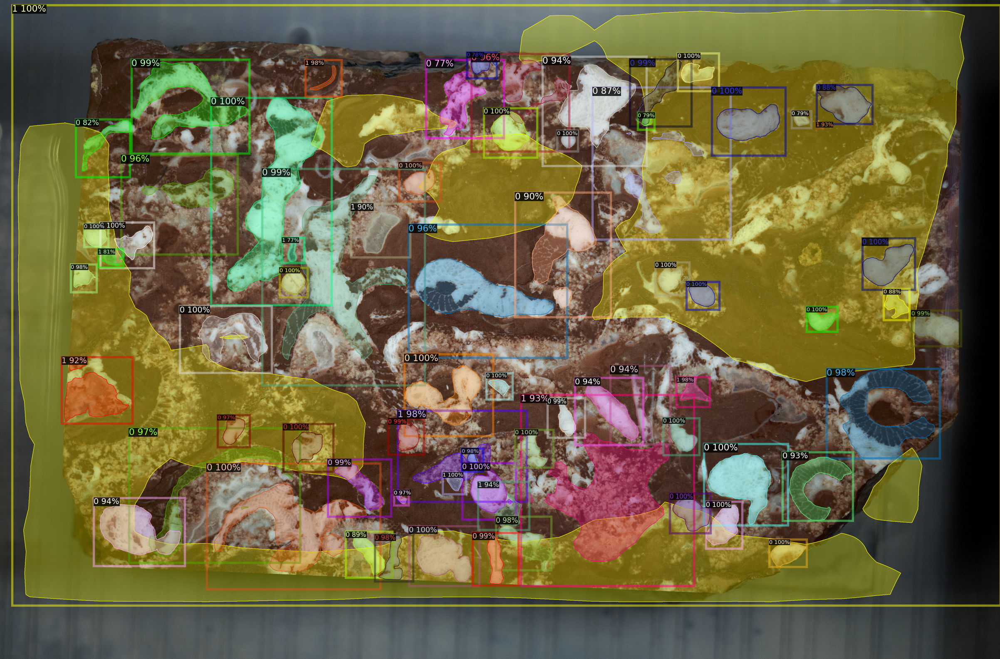

In [13]:
### visualize prediction with data augmentations for stack ###
cfg.MODEL.WEIGHTS = os.path.join(cfg.OUTPUT_DIR, "model_final.pth")  # path to the model we just trained
cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.75 # set a custom testing threshold
predictor = DefaultPredictor(cfg)

from detectron2.utils.visualizer import ColorMode

dataset_dicts = DatasetCatalog.get("stack")
for d in random.sample(dataset_dicts, 1):    
    im = cv2.imread(d["file_name"])
    outputs = predictor(im)  # format is documented at https://detectron2.readthedocs.io/tutorials/models.html#model-output-format
    v = Visualizer(im[:, :, ::-1],
                   metadata=MetadataCatalog.get("stack"), 
                   scale=0.5, 
                   instance_mode=ColorMode.IMAGE_BW   # remove the colors of unsegmented pixels. This option is only available for segmentation models
    )
    out = v.draw_instance_predictions(outputs["instances"].to("cpu"))
    cv2_imshow(out.get_image()[:, :, ::-1])

### Tensorboard

In [ ]:
# Look at training curves in tensorboard:
%load_ext tensorboard
%tensorboard --logdir drive/MyDrive/Colab\ Notebooks/detectron2_checkpoints/custom_augmentations

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard


Reusing TensorBoard on port 6006 (pid 781), started 1:26:04 ago. (Use '!kill 781' to kill it.)

<IPython.core.display.Javascript object>

## Sources
@misc{wu2019detectron2,
  author =       {Yuxin Wu and Alexander Kirillov and Francisco Massa and
                  Wan-Yen Lo and Ross Girshick},
  title =        {Detectron2},
  howpublished = {\url{https://github.com/facebookresearch/detectron2}},
  year =         {2019}
}